## *Nagłówek sprawozdania*

Bartosz Psik
<br>
325 211
<br>
09.05.2024r 14.15-17.00

# Analiza obrazu - detekcja twarzy

## Inicjalizacja
import bibliotek, pobranie do lokalnego środowiska wykonawczego przykładowego obrazu testowego i modeli dla detektorów twarzy

In [1]:
import cv2
from google.colab.patches import cv2_imshow

import dlib

# biblioteka insightface wymaga zainstalowania
!pip install insightface
!pip install onnxruntime

import insightface

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 439.5/439.5 kB 3.0 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.9/15.9 MB 42.3 MB/s eta 0:00:00
  Created wheel for insightface: filename=insightface-0.7.3-cp310-cp310-linux_x86_64.whl size=1054140 sha256=918f61e2b31f841a88f93a04d41916b532f4ea07210975c304439dc38ecaebe9
  Stored in directory: /root/.cache/pip/wheels/e3/d0/80/e3773fb8b6d1cca87ea1d33d9b1f20a223a6493c896da249b5
Successfully built insightface
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.8/6.8 MB 23.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 6.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 13.2 MB/s eta 0:00:00


In [43]:
import time

In [2]:
# obraz testowy
# https://drive.google.com/file/d/1dKxVJO0n5O6VuiHDdvrS36touzAeCgbw/view?usp=sharing
!gdown 1dKxVJO0n5O6VuiHDdvrS36touzAeCgbw

Downloading...
From: https://drive.google.com/uc?id=1dKxVJO0n5O6VuiHDdvrS36touzAeCgbw
To: /content/2_Demonstration_Demonstration_Or_Protest_2_58.jpg
100% 173k/173k [00:00<00:00, 80.7MB/s]


In [3]:
# model detektora Haar
# https://drive.google.com/file/d/1k2J4-4yIXrFFHZUhFv4pCRqcl-wB2Ve9/view?usp=sharing
!gdown 1k2J4-4yIXrFFHZUhFv4pCRqcl-wB2Ve9
!unzip haarcascade_frontalface_default.zip

Downloading...
From: https://drive.google.com/uc?id=1k2J4-4yIXrFFHZUhFv4pCRqcl-wB2Ve9
To: /content/haarcascade_frontalface_default.zip
100% 140k/140k [00:00<00:00, 116MB/s]
Archive:  haarcascade_frontalface_default.zip
  inflating: haarcascade_frontalface_default.xml  


In [4]:
# model detektora MMOD (sieć neuronowa z biblioteki dlib)
# https://drive.google.com/file/d/1gwFX_zny4A6DVkQ2gV2FlKY39qh1iDYj/view?usp=sharing
!gdown 1gwFX_zny4A6DVkQ2gV2FlKY39qh1iDYj

Downloading...
From: https://drive.google.com/uc?id=1gwFX_zny4A6DVkQ2gV2FlKY39qh1iDYj
To: /content/mmod_human_face_detector.dat
100% 730k/730k [00:00<00:00, 138MB/s]


In [5]:
# modele detektora twarzy (siec neuronowa) z biblioteki insightface
!gdown 1avyNxM0XoYh8YfxhhZoCvvI0lE7qT8Gy
!unzip insightface.zip

Downloading...
From: https://drive.google.com/uc?id=1avyNxM0XoYh8YfxhhZoCvvI0lE7qT8Gy
To: /content/insightface.zip
100% 23.4M/23.4M [00:00<00:00, 31.1MB/s]
Archive:  insightface.zip
   creating: insightface/models/
   creating: insightface/models/buffalo_l/
  inflating: insightface/models/buffalo_l/det_10g.onnx  
   creating: insightface/models/buffalo_m/
  inflating: insightface/models/buffalo_m/det_2.5g.onnx  
   creating: insightface/models/buffalo_s/
  inflating: insightface/models/buffalo_s/det_500m.onnx  
   creating: insightface/models/buffalo_sc/
  inflating: insightface/models/buffalo_sc/det_500m.onnx  


In [6]:
# obraz łatwy
#https://drive.google.com/file/d/1sYPRVOL-c1H0IW0muCFq18htKlDIqQjL/view?usp=sharing
!gdown 1sYPRVOL-c1H0IW0muCFq18htKlDIqQjL

Downloading...
From: https://drive.google.com/uc?id=1sYPRVOL-c1H0IW0muCFq18htKlDIqQjL
To: /content/0_Parade_marchingband_1_95.jpg
100% 142k/142k [00:00<00:00, 81.5MB/s]


In [7]:
# obraz trudny
# https://drive.google.com/file/d/1anR16ksibBMqQmZ5NUPyw-nW0NLYDidv/view?usp=sharing
! gdown 1anR16ksibBMqQmZ5NUPyw-nW0NLYDidv

Downloading...
From: https://drive.google.com/uc?id=1anR16ksibBMqQmZ5NUPyw-nW0NLYDidv
To: /content/2_Demonstration_Demonstration_Or_Protest_2_29.jpg
100% 116k/116k [00:00<00:00, 88.6MB/s]


In [8]:
# obraz średni
# https://drive.google.com/file/d/11hv84wBa1B0yQucbkTnGasj0GRkJXKpv/view?usp=sharing
!gdown 11hv84wBa1B0yQucbkTnGasj0GRkJXKpv

Downloading...
From: https://drive.google.com/uc?id=11hv84wBa1B0yQucbkTnGasj0GRkJXKpv
To: /content/7_Cheering_Cheering_7_16.jpg
100% 154k/154k [00:00<00:00, 103MB/s]


## Obraz testowy

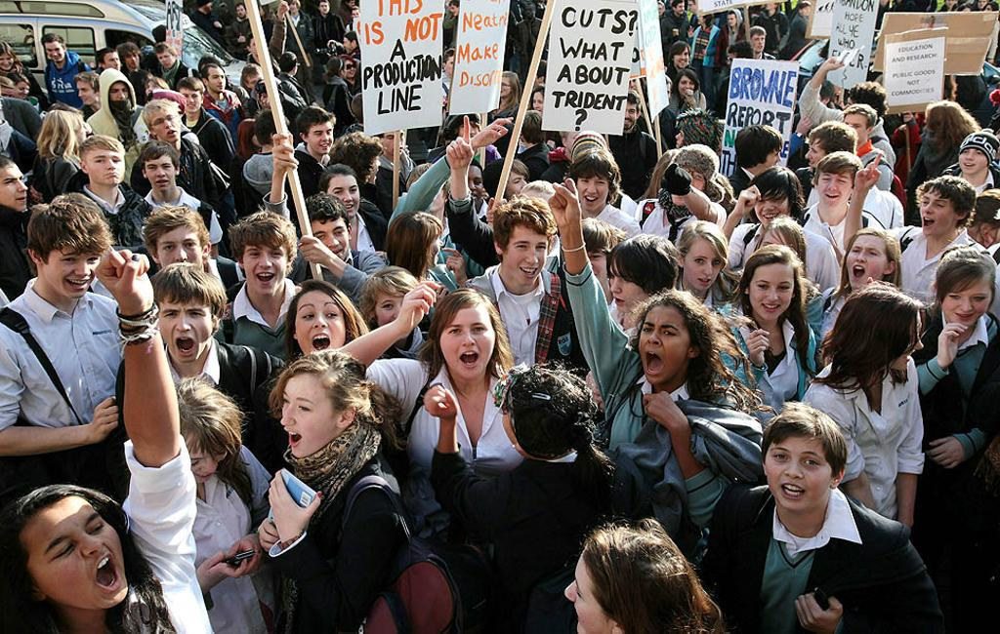

In [9]:
img = cv2.imread("2_Demonstration_Demonstration_Or_Protest_2_58.jpg")
# przygotowanie obrazów: monochromatycznego i RGB (cv2.imread() zwraca obraz w formacie BGR - inna kolejność składowych)
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

cv2_imshow(img)

## Kaskada Haara

Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/05/opencv-face-detection-with-haar-cascades/

In [10]:
# utworzenie i inicjalizacja detektora
haar_detector = cv2.CascadeClassifier("haarcascade_frontalface_default.xml")

23


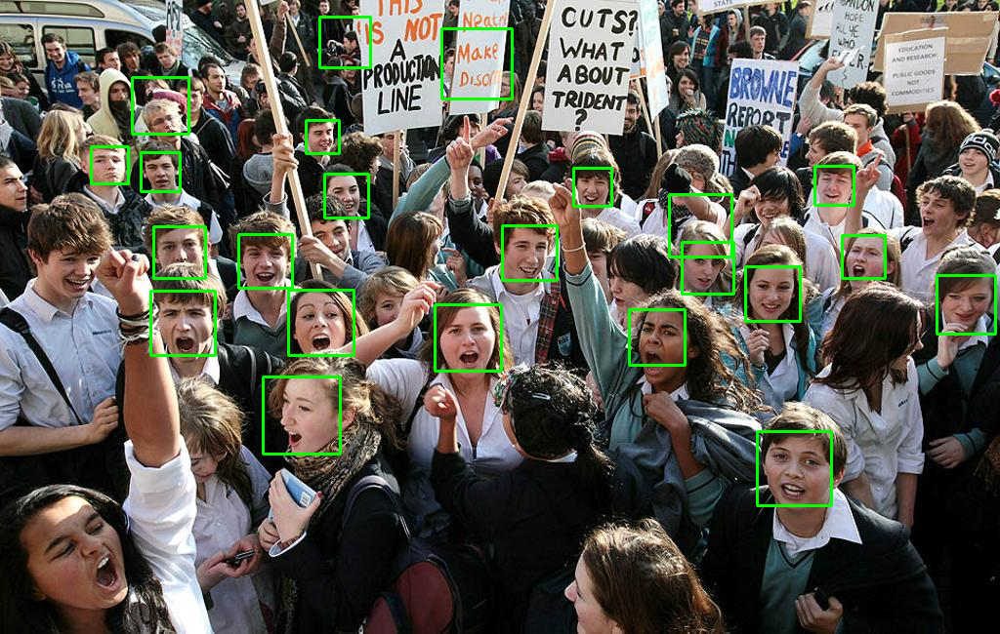

In [11]:
# wywołanie detektora dla określonego obrazu (img_gray)
# wynikiem jest lista prostokątów w formacie [x, y, width, height]
haar_results = haar_detector.detectMultiScale(img_gray, scaleFactor=1.05,
                                         minNeighbors=5, minSize=(30, 30),
																				 flags=cv2.CASCADE_SCALE_IMAGE)
print(len(haar_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_haar = img.copy()
for (x, y, w, h) in haar_results:
  cv2.rectangle(img_haar, (x, y), (x+w, y+h), (0, 255, 0), 2)
cv2_imshow(img_haar)

## Histogram zorientowanych gradientów (HOG) z maszyną wektorów nośnych (SVM)

Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/19/face-detection-with-dlib-hog-and-cnn/

In [12]:
# utworzenie i inicjalizacja detektora
hog_svm_detector = dlib.get_frontal_face_detector()

6


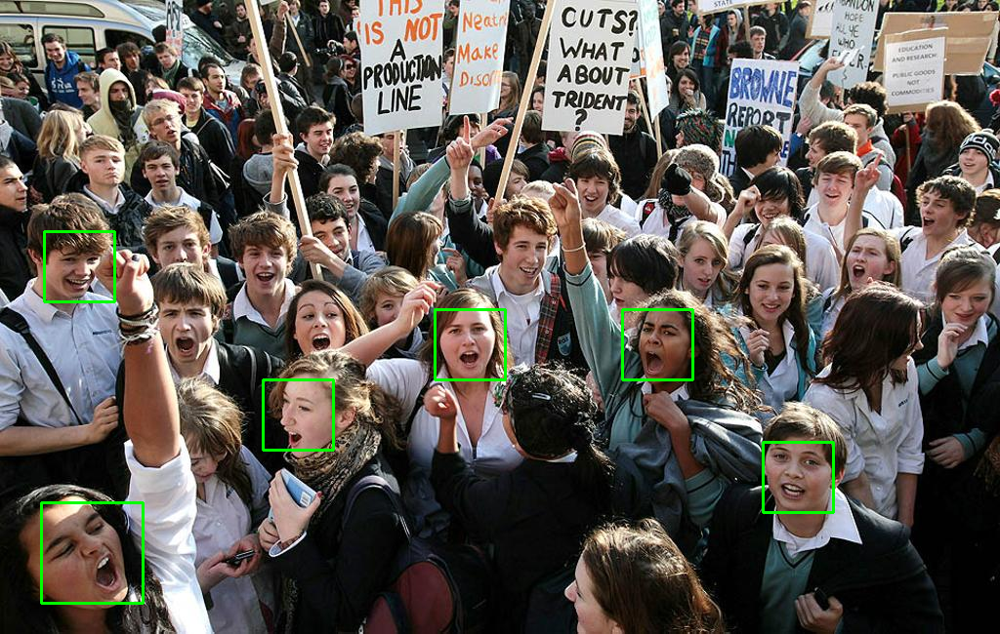

21


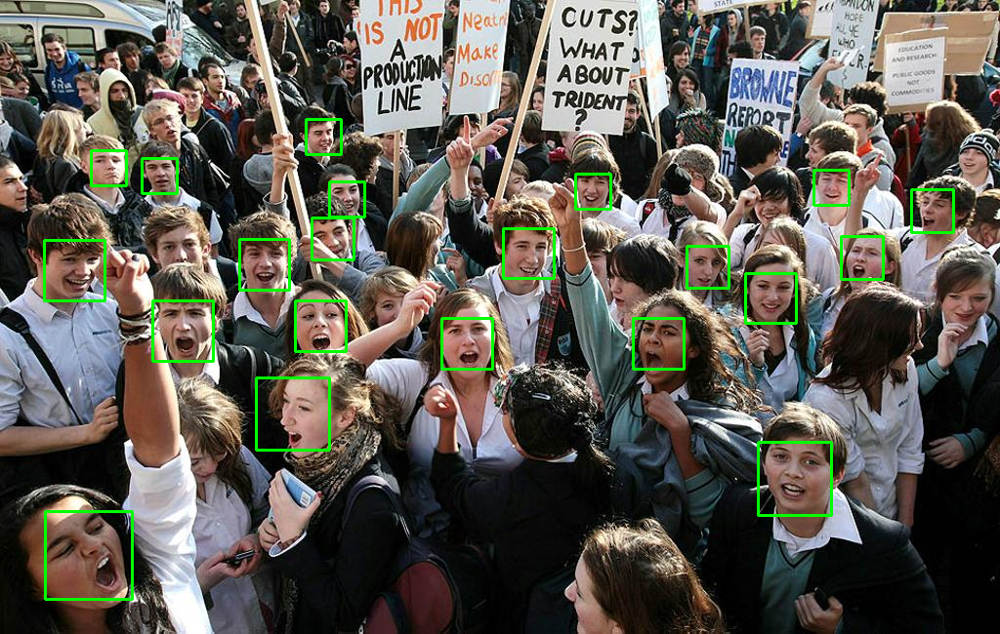

29


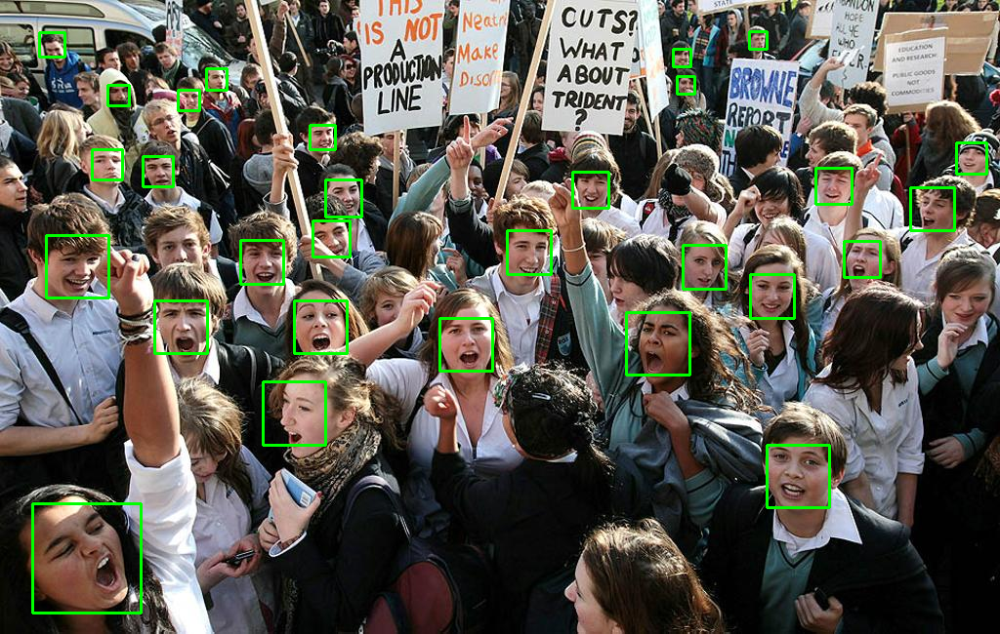

In [40]:
# wywołanie detektora dla określonego obrazu (img_rgb)
# wynikiem jest lista obiektów rectangle, zawierających współrzędne lewego górnego i prawego dolnego narożnika prostokąta
for i in range(3):
	hog_svm_results = hog_svm_detector(img_rgb, i)
	print(len(hog_svm_results))

	# narysowanie wyników na kopii obrazu i wyświetlenie
	img_hog_svm = img.copy()
	for rect in hog_svm_results:
		cv2.rectangle(img_hog_svm, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
	cv2_imshow(img_hog_svm)

### Porównanie wartości drugiego parametru detektora


In [39]:
values = [0, 1, 2]
results = []
for val in values:
  res = hog_svm_detector(img_rgb, val)
  results.append(len(res))

result_dict = dict(zip(values, results))
for key, value in result_dict.items():
    print(f"Value: {key}, Result: {value}")

Value: 0, Result: 6
Value: 1, Result: 21
Value: 2, Result: 29


Najlepsze wyniki uzyskaliśmy dla wartości 2


## Splotowa sieć neuronowa (CNN) z biblioteki dlib

Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/19/face-detection-with-dlib-hog-and-cnn/

In [15]:
# utworzenie i inicjalizacja detektora
cnn1_detector = dlib.cnn_face_detection_model_v1('mmod_human_face_detector.dat')

4


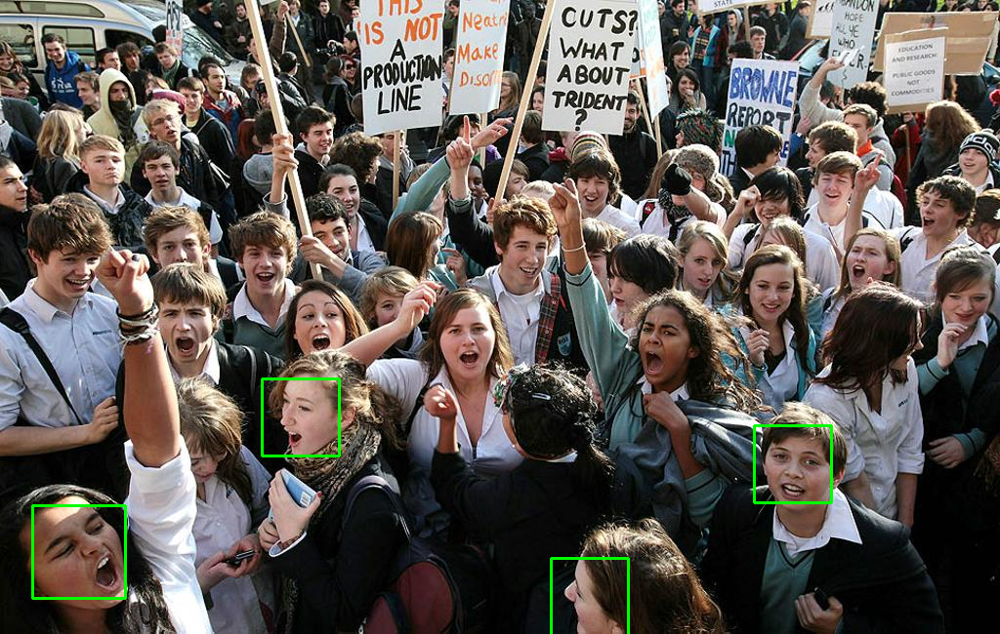

27


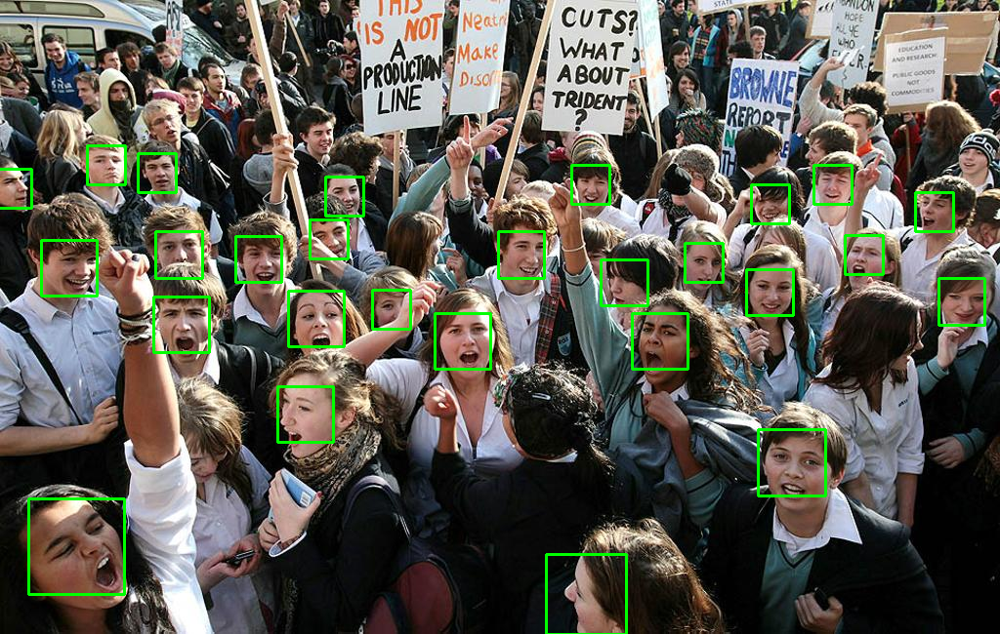

37


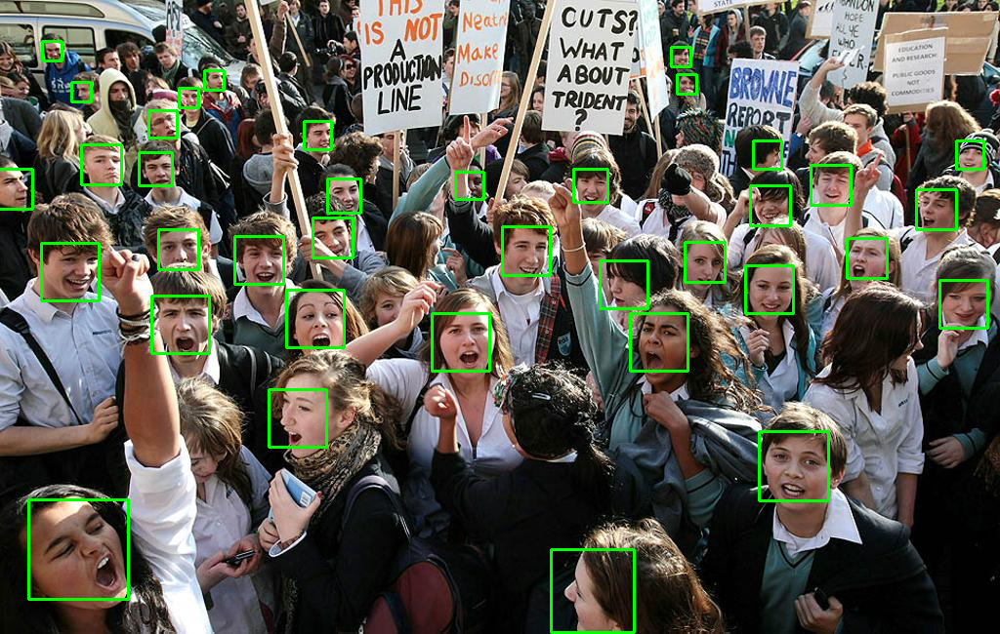

In [41]:
# wywołanie detektora dla określonego obrazu (img_rgb)
# wynikiem jest lista obiektów mmod_rectangle, zawierających m.in. pole rect ze współrzędnymi lewego górnego i prawego dolnego narożnika prostokąta
for i in range(3):
	cnn1_results = cnn1_detector(img_rgb, i)
	print(len(cnn1_results))

	# narysowanie wyników na kopii obrazu i wyświetlenie
	img_cnn1 = img.copy()
	for res in cnn1_results:
		rect = res.rect
		cv2.rectangle(img_cnn1, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
	cv2_imshow(img_cnn1)

In [17]:
values = [0, 1, 2]
results = []
for val in values:
  res = cnn1_detector(img_rgb, val)
  results.append(len(res))

result_dict = dict(zip(values, results))
for key, value in result_dict.items():
    print(f"Value: {key}, Result: {value}")

Value: 0, Result: 4
Value: 1, Result: 27
Value: 2, Result: 37


Podobnie dla CNN najlepsze wartości uzyskaliśmy dla wartości równej 2

## InsightFace - inna sieć neuronowa

Opracowano na podstawie: https://github.com/deepinsight/insightface/tree/master/python-package

In [18]:
# utworzenie i inicjalizacja detektora
model_name = 'buffalo_s'  # model: small (_s), medium (_m) lub large (_l)
insf_detector = insightface.app.FaceAnalysis(name=model_name, root='insightface',
                                             allowed_modules=['detection'], providers=['CPUExecutionProvider'])
insf_detector.prepare(ctx_id=0, det_size=(1024, 1024))

Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: insightface/models/buffalo_s/det_500m.onnx detection [1, 3, '?', '?'] 127.5 128.0
set det-size: (1024, 1024)


56


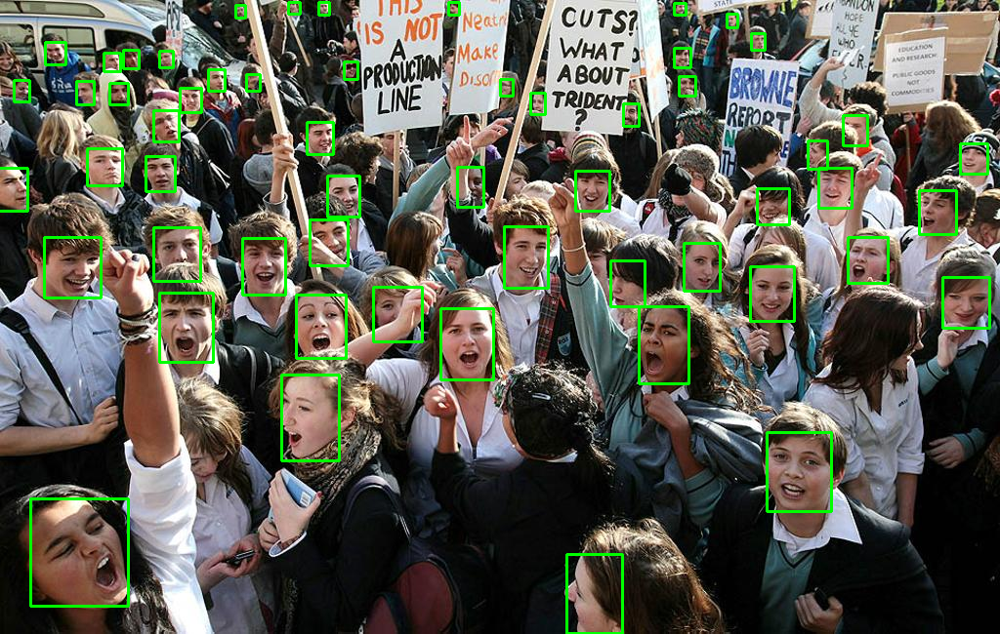

In [19]:
# wywołanie detektora dla określonego obrazu (img_rgb)
# wynikiem jest lista obiektów, zawierających m.in. pole bbox ze współrzędnymi lewego górnego i prawego dolnego narożnika prostokąta
insf_results = insf_detector.get(img)
print(len(insf_results))

# narysowanie wyników na kopii obrazu i wyświetlenie
img_insf = img.copy()
for res in insf_results:
  # współrzędne prostokątów sa zapisane jako liczby rzeczywiste - konwersja do liczb całkowitych
  rect = res.bbox.round().astype(int)
  cv2.rectangle(img_insf, (rect[0], rect[1]), (rect[2], rect[3]), (0, 255, 0), 2)
cv2_imshow(img_insf)

# WNIOSKI DO OBRAZU TESTOWEGO

# Założenia
<br>

 - Jeżeli została wykyty bok twarzy, albo częściowo przysłonięta twarz, ale my jako ludzie patrząc na zdjęcie jesteśmy w stanie powiedzieć, że jest to twarz, to zaliczamy to jako dobrze wykrytą twarz przez detektor
 - Jeżeli jest wykryta twarz i dość spory obszar zajmuje tło, ale nie ma tam więcej niż jednej twarzy, to też zaliczam jako dobrą detekcję
 - Zaproponowana przeze mnie miara to $\frac{liczba \  wykrytych \ kobiet}{liczby \ kobiet\ na \ zdjęciu}$ i oznaczę ją jako LK
 - Dla obrazu testowego liczba kobiet, którą wyliczyłem wynosi 20
 <br>

# Wyniki

| Metoda           | Ground Truths | Liczba wykrytych twarzy | FP | FN | LK |
| -----------      | --------------|-------------------------|    |    | |
| Kaskada Haara    | 101 |  20 | 3 |81 | 8 / 20 |
| HOG + SVM        | 101 |  29 | 0 | 72| 11 / 20|
| CNN              | 101 |  37 | 0 | 64 | 14 / 20|
| Insight Face     | 101 |  56 | 0 | 45 | 19 / 20|


- Najlepszą metodą do wykrywania twarzy okazała się metoda InsightFace. Wykryła najwięcej twarzy
- Tylko Kaskada Haara uznała obiekty niebędące twarzami, za twarze. Dała nam 3 false positives
- HOG + SVM i CNN nie dawały false positives, ale też nie wykryły wszystkich twarzy
- Różne detektory wykrywają na tych samych obrazach różne twarze (ale większość się pokrywa)
- Dla mojej miary widać, że najlepiej kobiety wykrywa InsightFace i wykrył 19 na 20 kobiet, które wyliczyłem

# FUNKCJE POMOCNICZE DO WYŚWIETLANIA OBRAZÓW Z WYKRYTYMI TWARZAMI

In [20]:
def use_haar(image):
  image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
  haar_results = haar_detector.detectMultiScale(image_gray, scaleFactor=1.05,
                                        minNeighbors=5, minSize=(30, 30),
                                        flags=cv2.CASCADE_SCALE_IMAGE)


  # narysowanie wyników na kopii obrazu i wyświetlenie
  img_haar = image.copy()
  for (x, y, w, h) in haar_results:
    cv2.rectangle(img_haar, (x, y), (x+w, y+h), (0, 255, 0), 2)
  cv2_imshow(img_haar)

def use_hog(image, quality=2):
  image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  hog_svm_results = hog_svm_detector(image_rgb, quality)

  # narysowanie wyników na kopii obrazu i wyświetlenie
  img_hog_svm = image.copy()
  for rect in hog_svm_results:
    cv2.rectangle(img_hog_svm, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
  cv2_imshow(img_hog_svm)

def use_cnn(image, quality=2):
  image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  cnn1_results = cnn1_detector(image_rgb, quality)

  # narysowanie wyników na kopii obrazu i wyświetlenie
  img_cnn1 = image.copy()
  for res in cnn1_results:
    rect = res.rect
    cv2.rectangle(img_cnn1, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
  cv2_imshow(img_cnn1)

def use_insight_face(image):
  insf_results = insf_detector.get(image)

  # narysowanie wyników na kopii obrazu i wyświetlenie
  img_insf = image.copy()
  for res in insf_results:
    # współrzędne prostokątów sa zapisane jako liczby rzeczywiste - konwersja do liczb całkowitych
    rect = res.bbox.round().astype(int)
    cv2.rectangle(img_insf, (rect[0], rect[1]), (rect[2], rect[3]), (0, 255, 0), 2)
  cv2_imshow(img_insf)

# OBRAZ ŁATWY

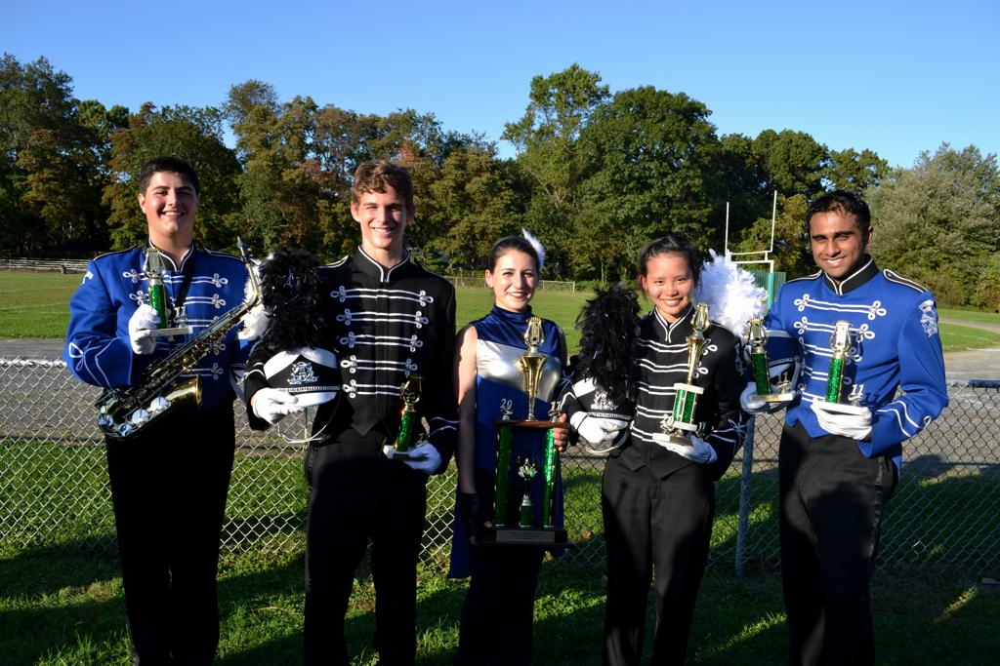

In [21]:
easy_img = cv2.imread("/content/0_Parade_marchingband_1_95.jpg")

cv2_imshow(easy_img)

### KASKADA HAARA

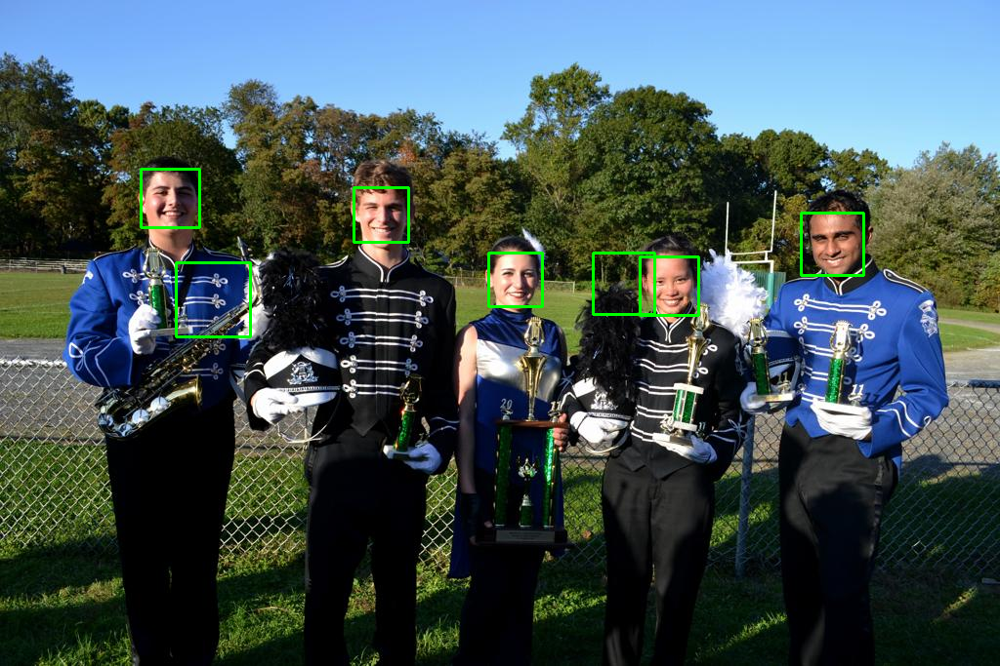

In [22]:
use_haar(easy_img)

### HOG

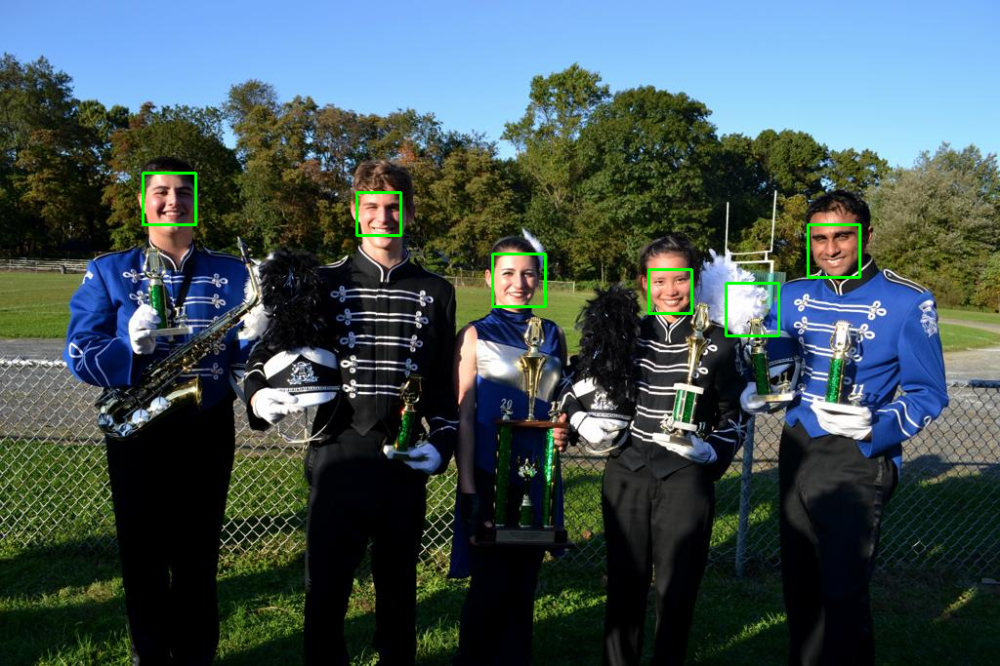

In [23]:
use_hog(easy_img)

### CNN

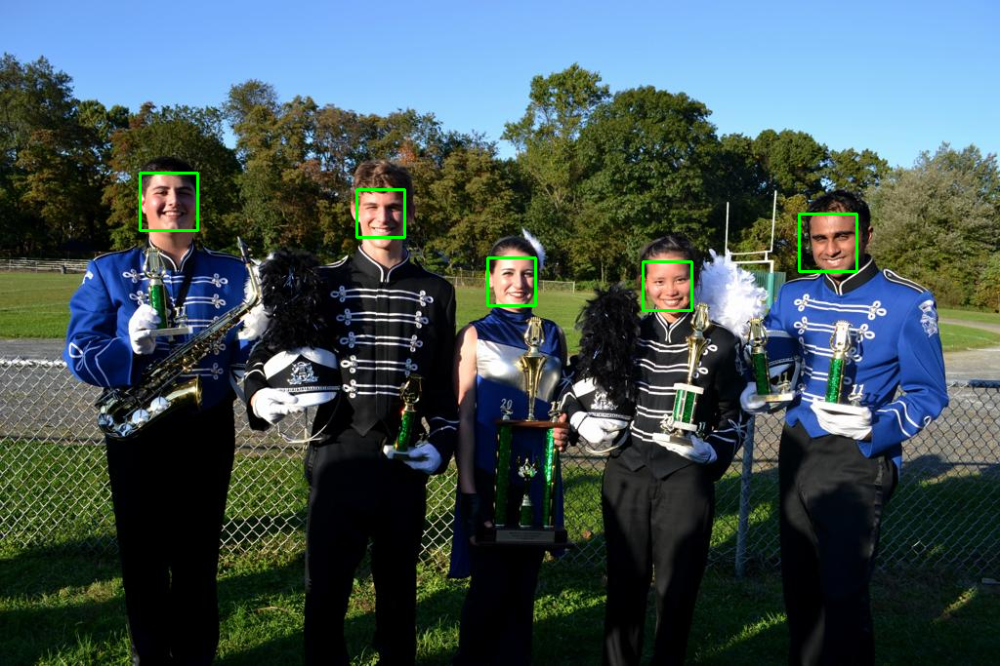

In [24]:
use_cnn(easy_img)

### Insight Face

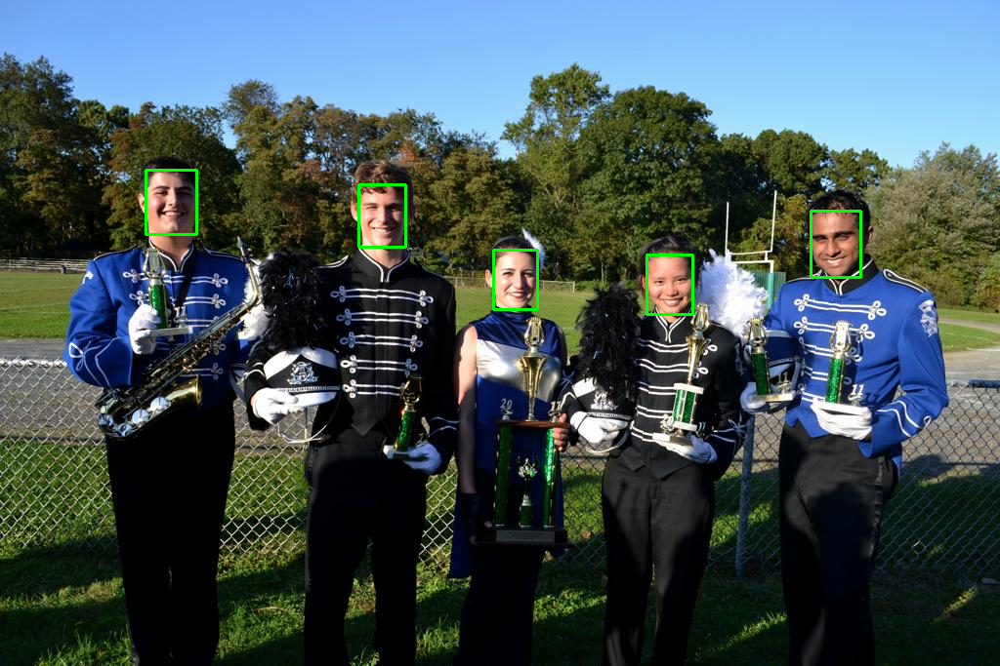

In [25]:
use_insight_face(easy_img)

## WNIOSKI

| Metoda           | Ground Truths | Liczba wykrytych twarzy | FP | FN | LK |
| -----------      | --------------|-------------------------|    |    |    |
| Kaskada Haara    |          5     |             5            | 2   |  0  | 2/2|
| HOG + SVM        |           5    |             5            |  1  | 0   |2/2|
| CNN              |            5   |              5           |  0  | 0   |2/2|
| Insight Face     |             5  |               5          |   0 |  0  |2/2|

- Detektory wykorzystujące sieci neuronowe najlepiej rozpoznały twarze. Miały 100% skuteczność
- Zarówno Kaskada Haara jak i HOG + SVM wykryły też wszystki twarze, ale dodatkowo dały nam w wynikach false positive -> uznały za twarze obieky, co nie są twarzami
- Wszystkie detektory miał 100% skteczność w wykrywaniu kobiet na zdjęciu. Może to wynikać z tego, że zdjęcie było bardzo proste i twarze dobrze widoczne


# OBRAZ ŚREDNI

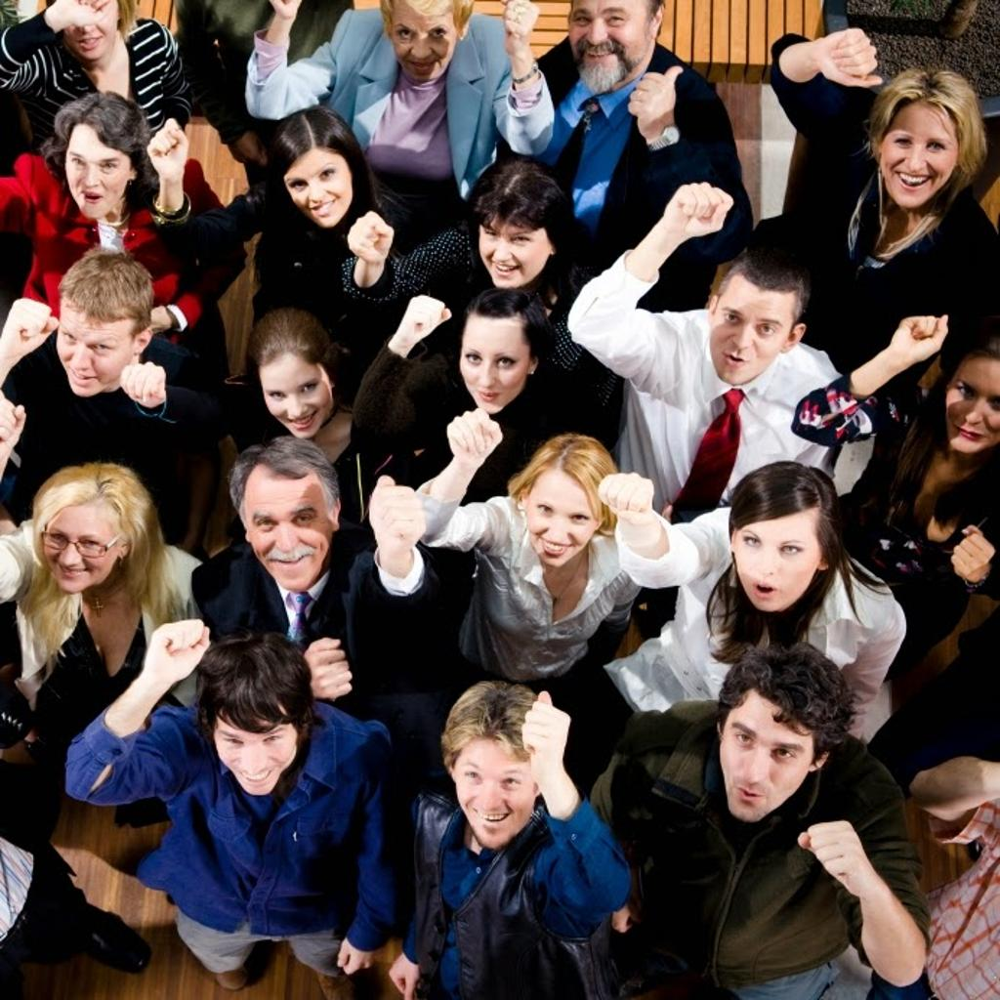

In [26]:
medium_img = cv2.imread("/content/7_Cheering_Cheering_7_16.jpg")

cv2_imshow(medium_img)

### HAAR

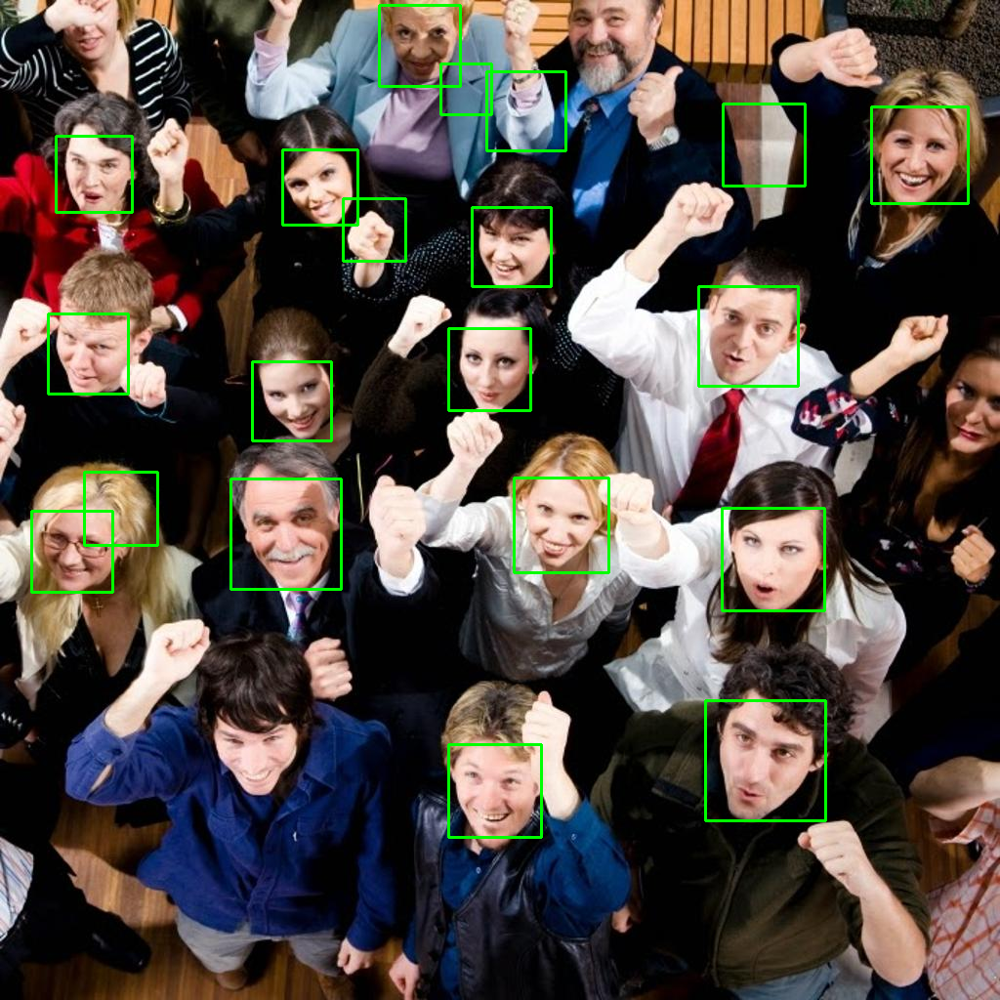

In [27]:
use_haar(medium_img)


### HOG + SVM

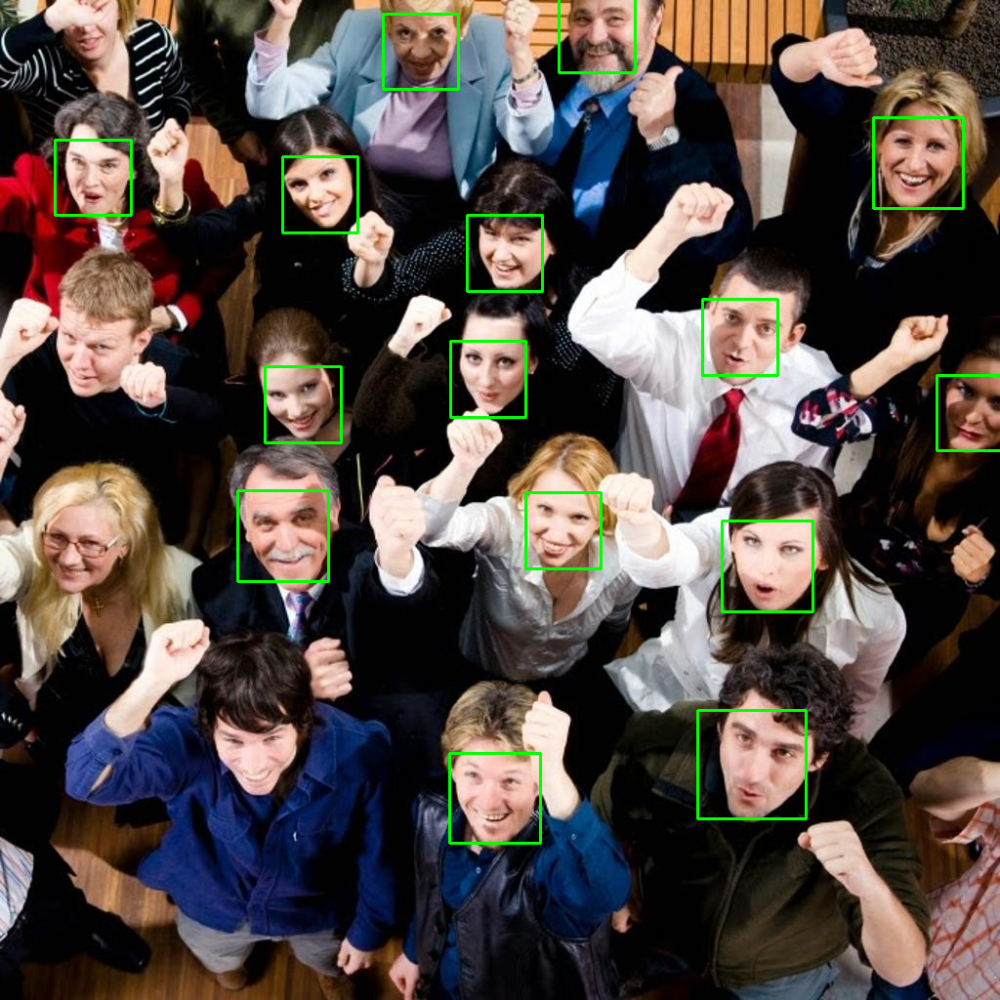

In [28]:
use_hog(medium_img)

### CNN

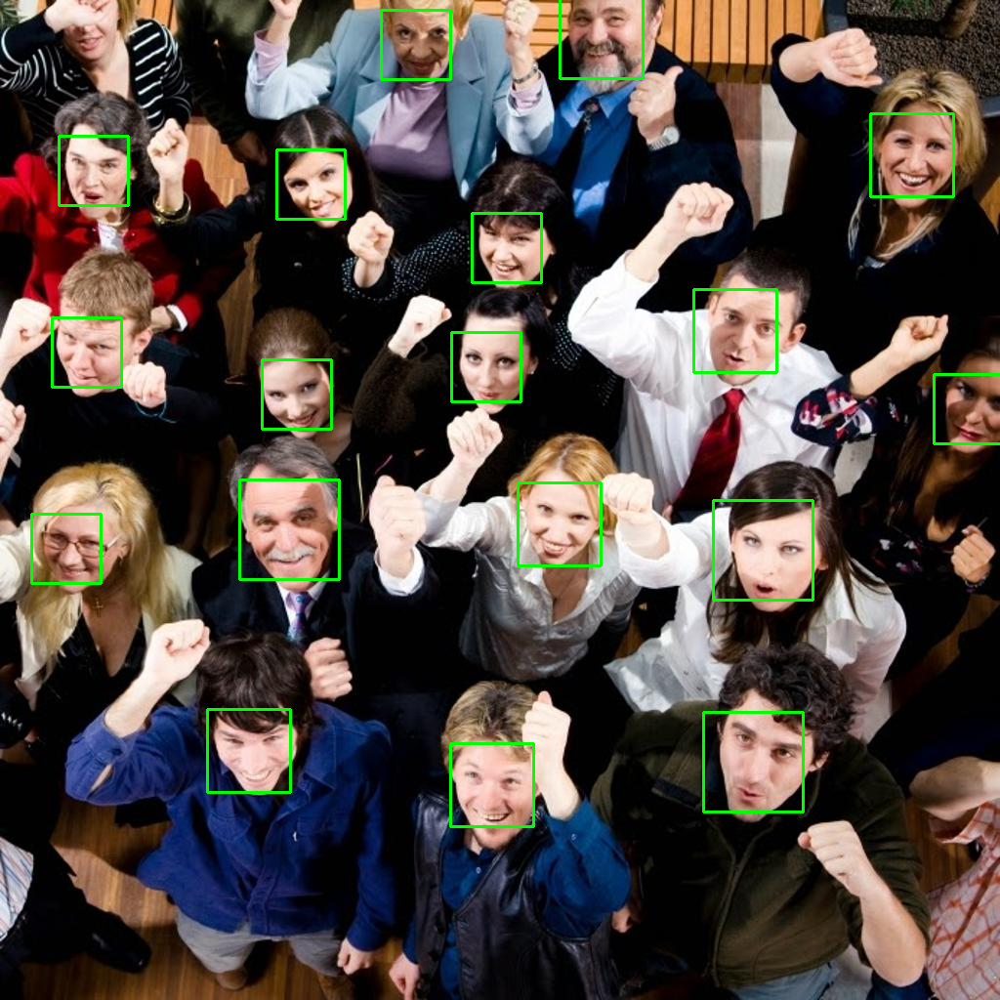

In [35]:
use_cnn(medium_img)

### InsightFace

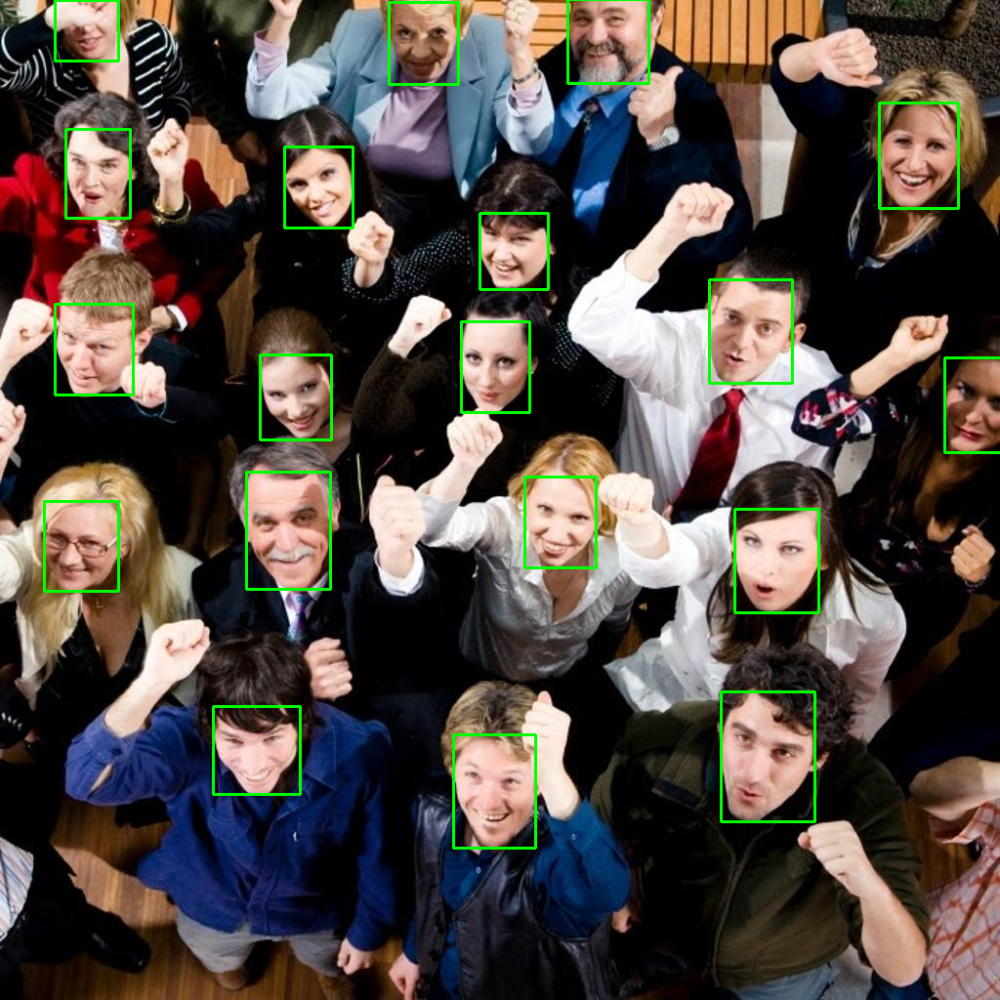

In [29]:
use_insight_face(medium_img)

## WNIOSKI

| Metoda           | Ground Truths | Liczba wykrytych twarzy | FP | FN | LK |
| -----------      | --------------|-------------------------|    |    | |
| Kaskada Haara    | 19 |  15 | 4 | 4 | 10 / 12 |
| HOG + SVM        | 19 |  15 | 0 | 4 | 10/12 |
| CNN              | 19 |   18 | 1 | 0 | 11/12|
| Insight Face     | 19 |  19 | 0 | 0 | 12/12|

- Podobnie jak dla obrazka łatwego najlepszą skuteczność odniosły CNN jak i InsightFace
- HOG + SVM i CNN nie wykryły wszystkich twarzy w ilościach odpowiednio 4 i 1
- Tylko Kaskada Haara uznała obiekty niebędące twarzami za twarze
- Jest to zdjęcie w miarę proste i również wszystkie metody zadziałały dość skutecznie

# OBRAZ TRUDNY

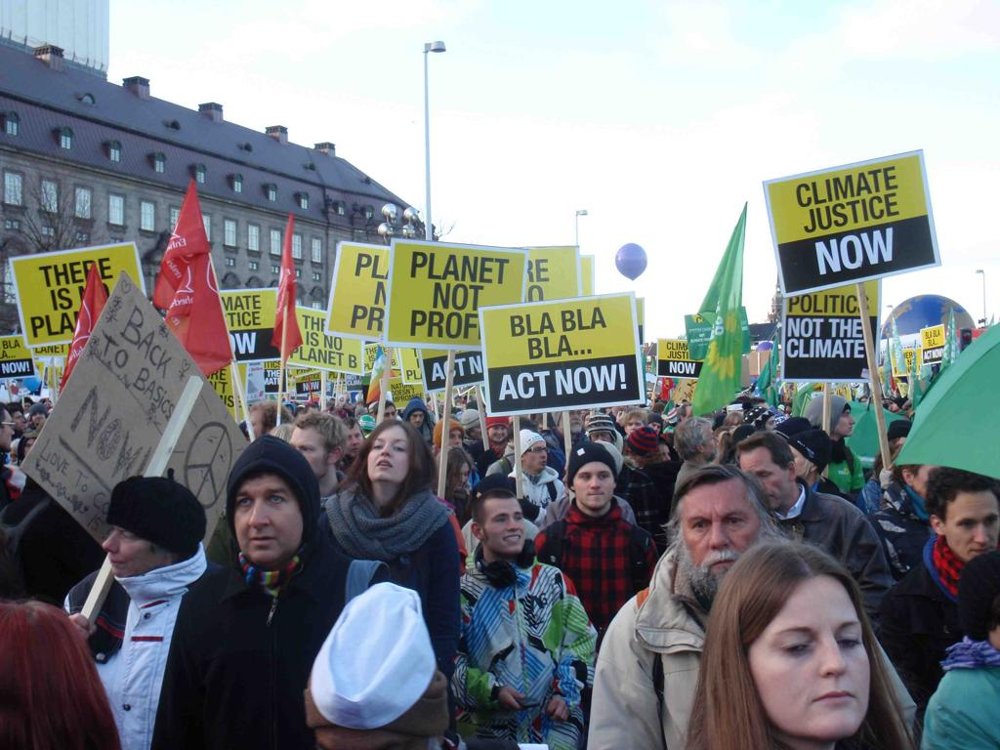

In [30]:
hard_img = cv2.imread("/content/2_Demonstration_Demonstration_Or_Protest_2_29.jpg")

cv2_imshow(hard_img)

### HAAR

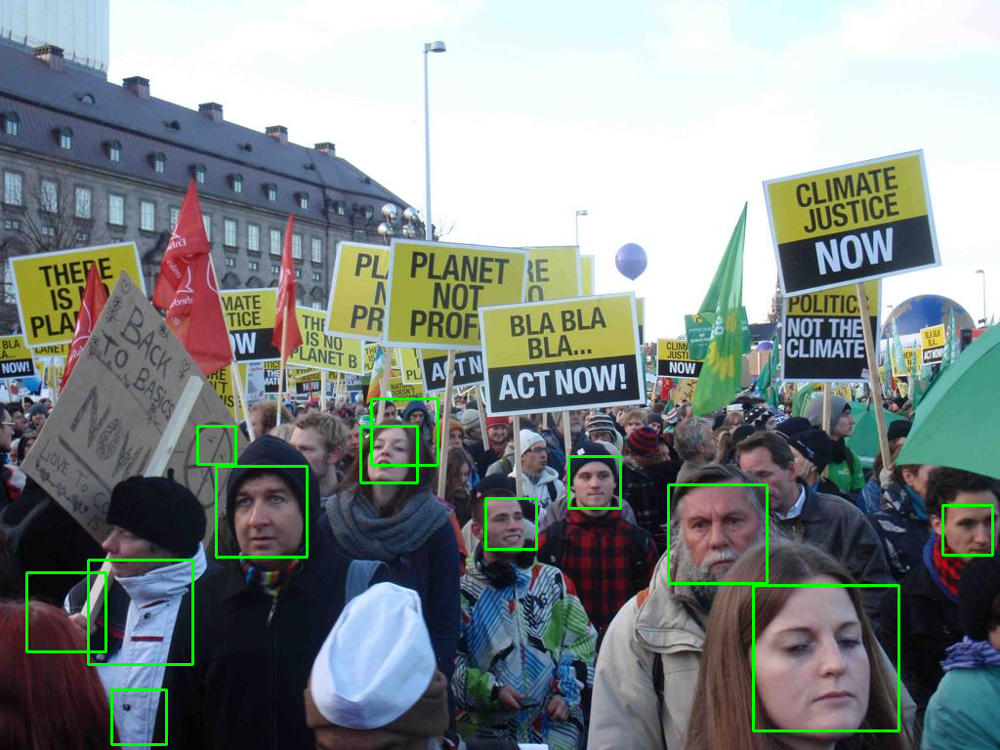

In [31]:
use_haar(hard_img)

- W tym przykłądzie mamy jeden box, który wykrył dwie twarze na raz i w tym przypadku nie uznaje go jako dobre wykrycie pojedyńczej twarzy

### HOG + SVM


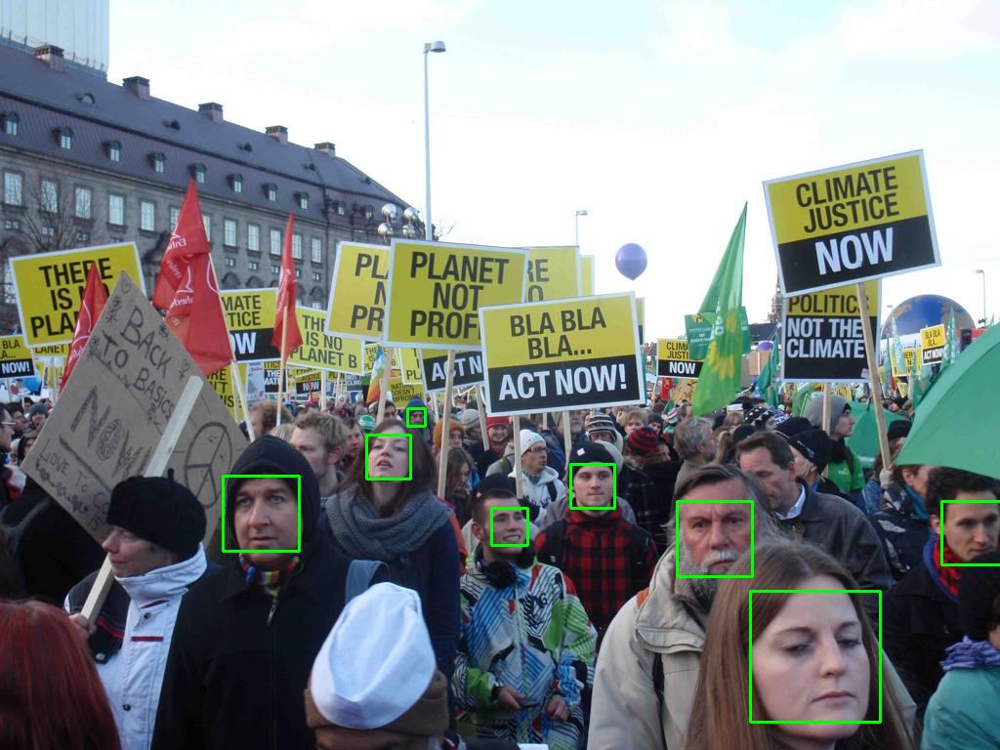

In [32]:
use_hog(hard_img)

### CNN

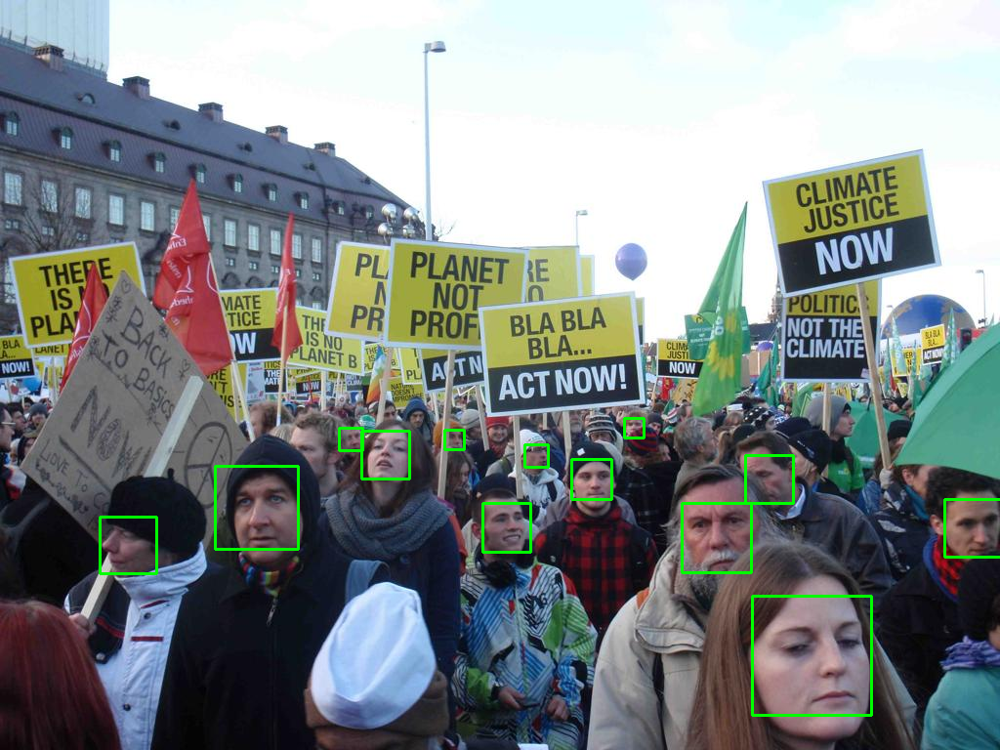

In [36]:
use_cnn(hard_img)

### InsightFace

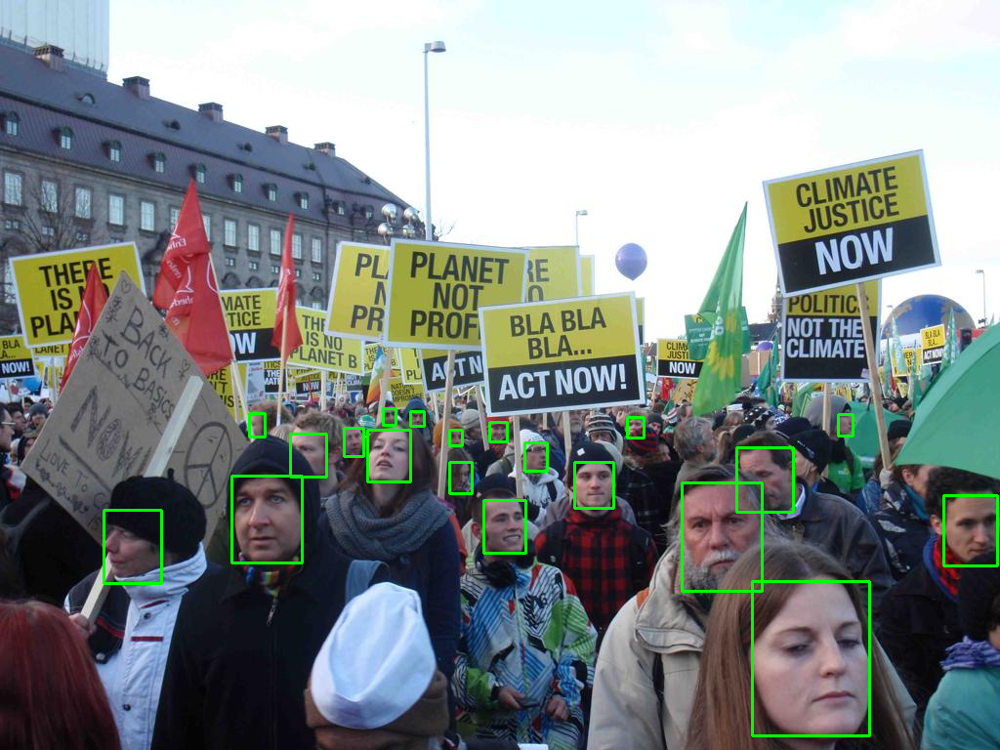

In [33]:
use_insight_face(hard_img)

## WNIOSKI

| Metoda           | Ground Truths | Liczba wykrytych twarzy | FP | FN | LK |
| -----------      | --------------|-------------------------|    |    | |
| Kaskada Haara    | 33 |  7 | 5 | 26 | 2/5|
| HOG + SVM        | 33 |  8 | 0 | 25 | 2/5|
| CNN              | 33 |  13 | 0 | 20 | 4/5|
| Insight Face     | 33 |  20 | 0 | 13 | 5/5|

- Byłem w stanie stweirdzić, że tylko 5 twarzy widocznych na zdjęciu należy do kobiet. Zdjęcie jest trudne, twarze są małe i czasami ciężko określić płeć
- Zdjęcie jest dosyć trudne, mamy dużo małych twarzy oraz wiele jest przysłoniętych dlatego wszystkie detektory poradziły sobie na nim już gorzej
- Najlepszym znowu okazał się InsightFace, a najgorszym Kaskada Haara

# WYNIKI Z WSZYSTKICH OBRAZÓW

| Metoda           | Ground Truths | Liczba wykrytych twarzy | FP | FN | LK |
| -----------      | --------------|-------------------------|    |    | |
| Kaskada Haara    |          158    |              47  | 14  |  111 | 22/39 |
| HOG + SVM        |             158 |                57   |  1  | 101  | 25/39 |
| CNN              |            158   |                73   |  1 | 84   | 31/39 |
| Insight Face     |             158  |               100    |   0 |  58 | 38/39 |

# WNIOSKI
- Najlepszym detektorem twarzy okazuje się InsightFace. Wykrywa on zarówno najwięcej twarzy ze wszystkich, najlepiej rozpoznaje kobiety oraz nie wykrywa żadnych FP
- Najgorszym detektorem jest Kaskada Haara (dlatego, jest to metoda już przestarzała). Wykrywa najmniej twarzy ze zdjęć oraz najczęściej błędnie ocenia czy dany fragment zdjęcia to twarz. Dał nam najwięcej FP, bo aż 14
- Dla prostych zdjęć, na których wszystkie twarze są dobrze widoczne i nie ma ich dużo. Wszystkie detektory dają nam dobrą skuteczność i dobrze wykrywają twarze i robią mało błędów
- Wraz z wzrostem "trudności zdjęcia" Kaskada Haara jak i HOG + SVM tracą na jakości i lepiej w takowych sytuacjach zastosować metody bazujące na sieciach neuronowych

# DETEKCJA CZASU


In [42]:
# inicjalizacja detektorów

# HARR   gray
haar_detector = cv2.CascadeClassifier("haarcascade_frontalface_default.xml")



# HOG rgb
hog_svm_detector = dlib.get_frontal_face_detector()



# CNN  rgb
cnn1_detector = dlib.cnn_face_detection_model_v1('mmod_human_face_detector.dat')


#InsightFace

model_name = 'buffalo_s'  # model: small (_s), medium (_m) lub large (_l)
insf_detector = insightface.app.FaceAnalysis(name=model_name, root='insightface',
                                             allowed_modules=['detection'], providers=['CPUExecutionProvider'])
insf_detector.prepare(ctx_id=0, det_size=(1024, 1024))



# funckje liczące wynik detektorów

def detect_haar(image_gray):
  haar_results = haar_detector.detectMultiScale(image_gray, scaleFactor=1.05,
                                         minNeighbors=5, minSize=(30, 30),
																				 flags=cv2.CASCADE_SCALE_IMAGE)

def detect_hog(image_rgb):
  hog_svm_results = hog_svm_detector(image_rgb, 2)

def detect_cnn(image_rgb):
  cnn1_results = cnn1_detector(image_rgb, 2)

def detect_if(image):
  insf_results = insf_detector.get(image)

Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: insightface/models/buffalo_s/det_500m.onnx detection [1, 3, '?', '?'] 127.5 128.0
set det-size: (1024, 1024)


In [51]:
images = [easy_img, medium_img, hard_img]
images_in_gray = [cv2.cvtColor(image, cv2.COLOR_BGR2GRAY) for image in images]
images_in_rgb = [cv2.cvtColor(image, cv2.COLOR_BGR2RGB) for image in images]

def calculate_times_dict(iterations):

  dict_with_times = {
      'Kaskada Haara': 0,
      'HOG': 0,
      'CNN' : 0,
      'IF' : 0
  }

  for i in range(0, iterations-1):
      # HARR
      st_haar = time.time()
      detect_haar(images_in_gray[i%3])
      end_harr = time.time()

      dict_with_times['Kaskada Haara'] += end_harr - st_haar

      # CNN
      st_cnn = time.time()
      detect_cnn(images_in_rgb[i%3])
      end_cnn = time.time()

      dict_with_times['CNN'] += end_cnn - st_cnn

      # HOG
      st_hog = time.time()
      detect_hog(images_in_rgb[i%3])
      end_hog = time.time()

      dict_with_times['HOG'] += end_hog - st_hog

      # IF
      st_if = time.time()
      detect_if(images[i%3])
      end_if = time.time()

      dict_with_times['IF'] += end_if - st_if

  return dict_with_times

def calculate_avg_time(dict_with_times, iterations):
    for key in dict_with_times.keys():
        time = dict_with_times[key] / iterations
        print(f"Metoda: {key}, Czas: {time}")



In [54]:
iterations = 20


for i in range(3):
  print("Iteracja : ", i)
  dictionary_with_time = calculate_times_dict(iterations)
  calculate_avg_time(dictionary_with_time, iterations)

Iteracja :  0
Metoda: Kaskada Haara, Czas: 0.9549247860908509
Metoda: HOG, Czas: 1.9658023595809937
Metoda: CNN, Czas: 0.6250534176826477
Metoda: IF, Czas: 0.1017235279083252
Iteracja :  1
Metoda: Kaskada Haara, Czas: 0.9363463759422302
Metoda: HOG, Czas: 1.9648291349411011
Metoda: CNN, Czas: 0.6174036860466003
Metoda: IF, Czas: 0.10554277896881104
Iteracja :  2
Metoda: Kaskada Haara, Czas: 0.957996416091919
Metoda: HOG, Czas: 1.996031367778778
Metoda: CNN, Czas: 0.6176560401916504
Metoda: IF, Czas: 0.10285462141036987


# Wnioski
- Najszybszą metodą okazała się metoda IF, która rezultat potrafi osiągnąć w 0.1 sekundy
- Najwolniejsza metoda to metoda korzystająca z HOG + SVM i jej wykonanie trwa w okolicach 2 sekund
- Zarówno CNN i Kaskada Haara wykonują się poniżej sekundy
- Wszystkie wyliczenia są raczej stabilne, wnioskuje to po podobieństwie w czasach dla 3 iteracji
- Wykorzystano GPU w środowisku Google Collab